In [2]:
# The script is used to integrate data between monkey cortex and mouse cortex data
suppressMessages(library(tidyverse))
suppressMessages(library(parallel))
suppressMessages(library(Seurat))
suppressMessages(library(SeuratData))
suppressMessages(library(patchwork))
suppressMessages(library(Matrix))
suppressMessages(library(viridis))
suppressMessages(library(cowplot))
suppressMessages(library(ggsci))
suppressMessages(library(pheatmap))
suppressMessages(library(RColorBrewer))
suppressMessages(library(reshape2))
suppressMessages(library(LSD))
suppressMessages(library(readxl))
suppressMessages(library(ggrepel))
suppressMessages(library(harmony))
suppressMessages(library(scrattch.hicat))
# suppressMessages(library(clusterProfiler))
# suppressMessages(library(GO.db))
# suppressMessages(library(biomaRt))
# suppressMessages(library(GSA))
suppressMessages(library(eulerr))
suppressMessages(library(enrichplot))
suppressMessages(library(clusterProfiler))
suppressMessages(library(org.Hs.eg.db))
suppressMessages(library(scales))
library(class)

In [2]:
outdir='/home/liuyx/liuyuxuan/spa_seurat/cla/speciesCompare/3species_compare_240130/data'

combineSeuratList=readRDS(paste0(outdir, "/3species_compare_seurat_ALL_ALL_List_0301.rds"))



In [10]:
sub_marmoset_marker=combineSeuratList[['marmoset']]
sub_mouse_marker=combineSeuratList[['mouse']]
sub_macaque_marker=combineSeuratList[['macaque']]
table(sub_marmoset_marker$SuperCluster)
table(sub_mouse_marker$SuperCluster)
table(sub_macaque_marker$SuperCluster)


     Astrocytes      Endotheial        GABA_CHC       GABA_DRD2      GABA_LAMP5 
           5607             293             304            5225             687 
GABA_LAMP5_LHX6      GABA_PVALB       GABA_RELN        GABA_SST        GABA_VIP 
           1096            6567             754            2686            1076 
     GLUT_GNB4-      GLUT_GNB4+       GLUT_VENO       Microglia           Oligo 
          22470           44443           11484             715            5664 
            OPC 
            315 


     Astrocytes      Endotheial        GABA_CHC       GABA_DRD2      GABA_LAMP5 
           6046           10385             662           19647            1623 
GABA_LAMP5_LHX6      GABA_PVALB       GABA_RELN        GABA_SST        GABA_VIP 
            545           13010            1322            8616             608 
     GLUT_GNB4-      GLUT_GNB4+       GLUT_VENO       Microglia           Oligo 
          62398           21942           69205            2889           13839 
            OPC 
           2249 


     Astrocytes      Endotheial        GABA_CHC       GABA_DRD2      GABA_LAMP5 
          23770            1396            1119            8164            2107 
GABA_LAMP5_LHX6      GABA_PVALB       GABA_RELN        GABA_SST        GABA_VIP 
           4168            8258            1896            3945            4636 
     GLUT_GNB4-      GLUT_GNB4+       GLUT_VENO       Microglia           Oligo 
          33872           78944            9190            3835           36250 
            OPC 
           6200 

In [4]:

Idents(sub_marmoset_marker) = "SuperCluster"
sub_marmoset_marker=subset(sub_marmoset_marker,downsample=1000)
DefaultAssay(sub_marmoset_marker) = "SCT"
marmosetSubclassMarker = FindAllMarkers(sub_marmoset_marker)

Idents(sub_mouse_marker) = "SuperCluster"
sub_mouse_marker=subset(sub_mouse_marker,downsample=1000)
DefaultAssay(sub_mouse_marker) = "SCT"
mouseSubclassMarker = FindAllMarkers(sub_mouse_marker)

Idents(sub_macaque_marker) = "SuperCluster"
sub_macaque_marker=subset(sub_macaque_marker,downsample=1000)
DefaultAssay(sub_macaque_marker) = "SCT"
macaqueSubclassMarker = FindAllMarkers(sub_macaque_marker)



Calculating cluster GLUT_GNB4+

Calculating cluster GLUT_VENO

Calculating cluster GLUT_GNB4-

Calculating cluster GABA_PVALB

Calculating cluster GABA_SST

Calculating cluster GABA_LAMP5_LHX6

Calculating cluster GABA_VIP

Calculating cluster GABA_RELN

Calculating cluster GABA_LAMP5

Calculating cluster GABA_CHC

Calculating cluster GABA_DRD2

Calculating cluster OPC

Calculating cluster Astrocytes

Calculating cluster Endotheial

Calculating cluster Oligo

Calculating cluster Microglia

Calculating cluster GLUT_VENO

Calculating cluster GLUT_GNB4+

Calculating cluster GLUT_GNB4-

Calculating cluster GABA_PVALB

Calculating cluster GABA_LAMP5

Calculating cluster GABA_SST

Calculating cluster GABA_VIP

Calculating cluster GABA_CHC

Calculating cluster GABA_LAMP5_LHX6

Calculating cluster GABA_RELN

Calculating cluster GABA_DRD2

Calculating cluster OPC

Calculating cluster Oligo

Calculating cluster Endotheial

Calculating cluster Astrocytes

Calculating cluster Microglia

Calculatin

In [5]:
write.csv(marmosetSubclassMarker,'/home/liuyx/liuyuxuan/spa_seurat/cla/speciesCompare/3species_compare_240130/data/marker_downsample_data/marmosetSubclassMarker_ALL.csv')
write.csv(macaqueSubclassMarker,'/home/liuyx/liuyuxuan/spa_seurat/cla/speciesCompare/3species_compare_240130/data/marker_downsample_data/macaqueSubclassMarker_ALL.csv')
write.csv(mouseSubclassMarker,'/home/liuyx/liuyuxuan/spa_seurat/cla/speciesCompare/3species_compare_240130/data/marker_downsample_data/mouseSubclassMarker_ALL.csv')


In [1]:
marmosetSubclassMarker=read.csv('/home/liuyx/liuyuxuan/spa_seurat/cla/speciesCompare/3species_compare_240130/data/marker_downsample_data/marmosetSubclassMarker_ALL.csv')
macaqueSubclassMarker=read.csv('/home/liuyx/liuyuxuan/spa_seurat/cla/speciesCompare/3species_compare_240130/data/marker_downsample_data/macaqueSubclassMarker_ALL.csv')
mouseSubclassMarker=read.csv('/home/liuyx/liuyuxuan/spa_seurat/cla/speciesCompare/3species_compare_240130/data/marker_downsample_data/mouseSubclassMarker_ALL.csv')


In [3]:
marmosetSubclassFiltMarker = subset(marmosetSubclassMarker, p_val_adj < 0.05 & avg_log2FC > 0.5)
mouseSubclassFiltMarker = subset(mouseSubclassMarker, p_val_adj < 0.05 & avg_log2FC > 0.5)
macaqueSubclassFiltMarker = subset(macaqueSubclassMarker, p_val_adj < 0.05 & avg_log2FC > 0.5)

marmosetSubclassFiltMarker$species = "marmoset"
mouseSubclassFiltMarker$species = "mouse"
macaqueSubclassFiltMarker$species = "macaque"

subclassFiltMarkerTb = as_tibble(Reduce(rbind, list(
    marmosetSubclassFiltMarker, mouseSubclassFiltMarker,
    macaqueSubclassFiltMarker
)))
str(subclassFiltMarkerTb)

subclassFiltMarkerTb = subclassFiltMarkerTb %>% group_by(cluster, gene) %>% mutate(
    conservedSpeciesNum = n(),
    conservedSpeciesPair = paste(sort(species), collapse="&"),
    conservedFlag = ifelse(
        conservedSpeciesNum == 3, "conserved", ifelse(
            conservedSpeciesNum == 1, "speciesDiff", "partialConserved"
        )
    )
) %>% ungroup()
table(subclassFiltMarkerTb$conservedFlag)

length(unique(subset(subclassFiltMarkerTb, conservedFlag=="conserved")$gene))
length(unique(subset(subclassFiltMarkerTb, conservedFlag=="partialConserved")$gene))
length(unique(subset(subclassFiltMarkerTb, conservedFlag=="speciesDiff")$gene))

subclassFiltMarkerTb$cluster = factor(as.character(subclassFiltMarkerTb$cluster))
subclassFiltMarkerTb = subclassFiltMarkerTb %>% arrange(species, cluster, avg_log2FC)
levels(subclassFiltMarkerTb$cluster)

head(subclassFiltMarkerTb)


tibble [8,187 × 9] (S3: tbl_df/tbl/data.frame)
 $ X         : chr [1:8187] "ZNF804B" "NTNG2" "RGS12" "NR4A2" ...
 $ p_val     : num [1:8187] 0.00 0.00 0.00 0.00 9.09e-308 ...
 $ avg_log2FC: num [1:8187] 1.8 1.52 1.43 1.18 1.43 ...
 $ pct.1     : num [1:8187] 0.941 0.859 0.83 0.791 0.951 0.512 0.994 0.713 0.734 0.772 ...
 $ pct.2     : num [1:8187] 0.479 0.218 0.289 0.23 0.63 0.105 0.747 0.221 0.268 0.315 ...
 $ p_val_adj : num [1:8187] 0.00 0.00 0.00 0.00 2.74e-303 ...
 $ cluster   : chr [1:8187] "GLUT_GNB4+" "GLUT_GNB4+" "GLUT_GNB4+" "GLUT_GNB4+" ...
 $ gene      : chr [1:8187] "ZNF804B" "NTNG2" "RGS12" "NR4A2" ...
 $ species   : chr [1:8187] "marmoset" "marmoset" "marmoset" "marmoset" ...



       conserved partialConserved      speciesDiff 
            1902             2356             3929 

[1] 518

[1] 927

[1] 2763

[1] "Astrocytes"      "Endotheial"      "GABA_CHC"        "GABA_DRD2"      
 [5] "GABA_LAMP5"      "GABA_LAMP5_LHX6" "GABA_PVALB"      "GABA_RELN"      
 [9] "GABA_SST"        "GABA_VIP"        "GLUT_GNB4-"      "GLUT_GNB4+"     
[13] "GLUT_VENO"       "Microglia"       "Oligo"           "OPC"

X,p_val,avg_log2FC,pct.1,pct.2,p_val_adj,cluster,gene,species,conservedSpeciesNum,conservedSpeciesPair,conservedFlag
<chr>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<fct>,<chr>,<chr>,<int>,<chr>,<chr>
ENSMFAG00000043717.1,1.351217e-38,0.5020022,0.340,0.195,2.858229e-34,Astrocytes,ENSMFAG00000043717,macaque,1,macaque,speciesDiff
PRDX6,1.371692e-160,0.5030928,0.247,0.045,2.901539e-156,Astrocytes,PRDX6,macaque,2,macaque&mouse,partialConserved
STOM,2.183351e-152,0.5031399,0.272,0.055,4.618441e-148,Astrocytes,STOM,macaque,1,macaque,speciesDiff
FAM13A.2,3.166653e-23,0.5067942,0.252,0.149,6.698421e-19,Astrocytes,FAM13A,macaque,1,macaque,speciesDiff
STK17B,3.444670e-232,0.5069497,0.213,0.022,7.286509e-228,Astrocytes,STK17B,macaque,1,macaque,speciesDiff
PDLIM3.1,2.093939e-131,0.5096996,0.203,0.036,4.429308e-127,Astrocytes,PDLIM3,macaque,1,macaque,speciesDiff


In [4]:
length(unique(subclassFiltMarkerTb$gene))

[1] 3348

In [5]:
length(unique(subclassFiltMarkerTb$cluster))
unique(subclassFiltMarkerTb$cluster)

[1] 16

[1] Astrocytes      Endotheial      GABA_CHC        GABA_DRD2      
 [5] GABA_LAMP5      GABA_LAMP5_LHX6 GABA_PVALB      GABA_RELN      
 [9] GABA_SST        GABA_VIP        GLUT_GNB4-      GLUT_GNB4+     
[13] GLUT_VENO       Microglia       Oligo           OPC            
16 Levels: Astrocytes Endotheial GABA_CHC GABA_DRD2 ... OPC

In [6]:
tmpTb = subset(subclassFiltMarkerTb, cluster == "Astrocytes") %>% group_by(gene, conservedSpeciesPair) %>% summarize() %>% ungroup()
table(tmpTb$conservedSpeciesPair)
any(duplicated(tmpTb$gene))
elr16 = euler(setNames(as.integer(table(tmpTb$conservedSpeciesPair)), as.character(names(table(tmpTb$conservedSpeciesPair)))))

tmpTb = subset(subclassFiltMarkerTb, cluster == "Endotheial") %>% group_by(gene, conservedSpeciesPair) %>% summarize() %>% ungroup()
table(tmpTb$conservedSpeciesPair)
any(duplicated(tmpTb$gene))
elr12 = euler(setNames(as.integer(table(tmpTb$conservedSpeciesPair)), as.character(names(table(tmpTb$conservedSpeciesPair)))))

tmpTb = subset(subclassFiltMarkerTb, cluster == "Microglia") %>% group_by(gene, conservedSpeciesPair) %>% summarize() %>% ungroup()
table(tmpTb$conservedSpeciesPair)
any(duplicated(tmpTb$gene))
elr13 = euler(setNames(as.integer(table(tmpTb$conservedSpeciesPair)), as.character(names(table(tmpTb$conservedSpeciesPair)))))

tmpTb = subset(subclassFiltMarkerTb, cluster == "Oligo") %>% group_by(gene, conservedSpeciesPair) %>% summarize() %>% ungroup()
table(tmpTb$conservedSpeciesPair)
any(duplicated(tmpTb$gene))
elr14 = euler(setNames(as.integer(table(tmpTb$conservedSpeciesPair)), as.character(names(table(tmpTb$conservedSpeciesPair)))))

tmpTb = subset(subclassFiltMarkerTb, cluster == "OPC") %>% group_by(gene, conservedSpeciesPair) %>% summarize() %>% ungroup()
table(tmpTb$conservedSpeciesPair)
any(duplicated(tmpTb$gene))
elr15 = euler(setNames(as.integer(table(tmpTb$conservedSpeciesPair)), as.character(names(table(tmpTb$conservedSpeciesPair)))))


tmpTb = subset(subclassFiltMarkerTb, cluster == "GLUT_GNB4-") %>% group_by(gene, conservedSpeciesPair) %>% summarize() %>% ungroup()
table(tmpTb$conservedSpeciesPair)
any(duplicated(tmpTb$gene))
elr1 = euler(setNames(as.integer(table(tmpTb$conservedSpeciesPair)), as.character(names(table(tmpTb$conservedSpeciesPair)))))

tmpTb = subset(subclassFiltMarkerTb, cluster == "GLUT_GNB4+") %>% group_by(gene, conservedSpeciesPair) %>% summarize() %>% ungroup()
table(tmpTb$conservedSpeciesPair)
any(duplicated(tmpTb$gene))
elr2 = euler(setNames(as.integer(table(tmpTb$conservedSpeciesPair)), as.character(names(table(tmpTb$conservedSpeciesPair)))))

tmpTb = subset(subclassFiltMarkerTb, cluster == "GLUT_VENO") %>% group_by(gene, conservedSpeciesPair) %>% summarize() %>% ungroup()
table(tmpTb$conservedSpeciesPair)
any(duplicated(tmpTb$gene))
elr3 = euler(setNames(as.integer(table(tmpTb$conservedSpeciesPair)), as.character(names(table(tmpTb$conservedSpeciesPair)))))

tmpTb = subset(subclassFiltMarkerTb, cluster == "GABA_CHC") %>% group_by(gene, conservedSpeciesPair) %>% summarize() %>% ungroup()
table(tmpTb$conservedSpeciesPair)
any(duplicated(tmpTb$gene))
elr4 = euler(setNames(as.integer(table(tmpTb$conservedSpeciesPair)), as.character(names(table(tmpTb$conservedSpeciesPair)))))

tmpTb = subset(subclassFiltMarkerTb, cluster == "GABA_LAMP5") %>% group_by(gene, conservedSpeciesPair) %>% summarize() %>% ungroup()
table(tmpTb$conservedSpeciesPair)
any(duplicated(tmpTb$gene))
elr5 = euler(setNames(as.integer(table(tmpTb$conservedSpeciesPair)), as.character(names(table(tmpTb$conservedSpeciesPair)))))

tmpTb = subset(subclassFiltMarkerTb, cluster == "GABA_LAMP5_LHX6") %>% group_by(gene, conservedSpeciesPair) %>% summarize() %>% ungroup()
table(tmpTb$conservedSpeciesPair)
any(duplicated(tmpTb$gene))
elr6 = euler(setNames(as.integer(table(tmpTb$conservedSpeciesPair)), as.character(names(table(tmpTb$conservedSpeciesPair)))))

tmpTb = subset(subclassFiltMarkerTb, cluster == "GABA_PVALB") %>% group_by(gene, conservedSpeciesPair) %>% summarize() %>% ungroup()
table(tmpTb$conservedSpeciesPair)
any(duplicated(tmpTb$gene))
elr7 = euler(setNames(as.integer(table(tmpTb$conservedSpeciesPair)), as.character(names(table(tmpTb$conservedSpeciesPair)))))

tmpTb = subset(subclassFiltMarkerTb, cluster == "GABA_RELN") %>% group_by(gene, conservedSpeciesPair) %>% summarize() %>% ungroup()
table(tmpTb$conservedSpeciesPair)
any(duplicated(tmpTb$gene))
elr8 = euler(setNames(as.integer(table(tmpTb$conservedSpeciesPair)), as.character(names(table(tmpTb$conservedSpeciesPair)))))

tmpTb = subset(subclassFiltMarkerTb, cluster == "GABA_SST") %>% group_by(gene, conservedSpeciesPair) %>% summarize() %>% ungroup()
table(tmpTb$conservedSpeciesPair)
any(duplicated(tmpTb$gene))
elr9 = euler(setNames(as.integer(table(tmpTb$conservedSpeciesPair)), as.character(names(table(tmpTb$conservedSpeciesPair)))))

tmpTb = subset(subclassFiltMarkerTb, cluster == "GABA_VIP") %>% group_by(gene, conservedSpeciesPair) %>% summarize() %>% ungroup()
table(tmpTb$conservedSpeciesPair)
any(duplicated(tmpTb$gene))
elr10 = euler(setNames(as.integer(table(tmpTb$conservedSpeciesPair)), as.character(names(table(tmpTb$conservedSpeciesPair)))))

tmpTb = subset(subclassFiltMarkerTb, cluster == "GABA_DRD2") %>% group_by(gene, conservedSpeciesPair) %>% summarize() %>% ungroup()
table(tmpTb$conservedSpeciesPair)
any(duplicated(tmpTb$gene))
elr11 = euler(setNames(as.integer(table(tmpTb$conservedSpeciesPair)), as.character(names(table(tmpTb$conservedSpeciesPair)))))


`summarise()` has grouped output by 'gene'. You can override using the
`.groups` argument.



               macaque       macaque&marmoset macaque&marmoset&mouse 
                   169                     56                     52 
         macaque&mouse               marmoset         marmoset&mouse 
                    19                     42                     18 
                 mouse 
                    65 

[1] FALSE

`summarise()` has grouped output by 'gene'. You can override using the
`.groups` argument.



               macaque       macaque&marmoset macaque&marmoset&mouse 
                   149                     25                    118 
         macaque&mouse               marmoset         marmoset&mouse 
                    70                     84                     58 
                 mouse 
                   407 

[1] FALSE

`summarise()` has grouped output by 'gene'. You can override using the
`.groups` argument.



               macaque       macaque&marmoset macaque&marmoset&mouse 
                   158                     30                      9 
         macaque&mouse               marmoset         marmoset&mouse 
                    10                     74                     13 
                 mouse 
                    55 

[1] FALSE

`summarise()` has grouped output by 'gene'. You can override using the
`.groups` argument.



               macaque       macaque&marmoset macaque&marmoset&mouse 
                   185                     36                     42 
         macaque&mouse               marmoset         marmoset&mouse 
                    24                     47                      8 
                 mouse 
                    76 

[1] FALSE

`summarise()` has grouped output by 'gene'. You can override using the
`.groups` argument.



               macaque       macaque&marmoset macaque&marmoset&mouse 
                    85                     24                     26 
         macaque&mouse               marmoset         marmoset&mouse 
                    12                     97                     10 
                 mouse 
                    65 

[1] FALSE

`summarise()` has grouped output by 'gene'. You can override using the
`.groups` argument.



               macaque       macaque&marmoset macaque&marmoset&mouse 
                    65                     35                     31 
         macaque&mouse               marmoset         marmoset&mouse 
                    11                     37                     13 
                 mouse 
                    35 

[1] FALSE

`summarise()` has grouped output by 'gene'. You can override using the
`.groups` argument.



               macaque       macaque&marmoset macaque&marmoset&mouse 
                   107                     36                     41 
         macaque&mouse               marmoset         marmoset&mouse 
                    31                     60                      9 
                 mouse 
                    92 

[1] FALSE

`summarise()` has grouped output by 'gene'. You can override using the
`.groups` argument.



               macaque       macaque&marmoset macaque&marmoset&mouse 
                    77                     45                     37 
         macaque&mouse               marmoset         marmoset&mouse 
                     8                     63                     13 
                 mouse 
                    62 

[1] FALSE

`summarise()` has grouped output by 'gene'. You can override using the
`.groups` argument.



               macaque       macaque&marmoset macaque&marmoset&mouse 
                    84                     50                     23 
         macaque&mouse               marmoset         marmoset&mouse 
                    20                     81                     12 
                 mouse 
                    67 

[1] FALSE

`summarise()` has grouped output by 'gene'. You can override using the
`.groups` argument.



               macaque       macaque&marmoset macaque&marmoset&mouse 
                    59                     46                     33 
         macaque&mouse               marmoset         marmoset&mouse 
                    11                     59                     15 
                 mouse 
                    79 

[1] FALSE

`summarise()` has grouped output by 'gene'. You can override using the
`.groups` argument.



               macaque       macaque&marmoset macaque&marmoset&mouse 
                    67                     47                     26 
         macaque&mouse               marmoset         marmoset&mouse 
                    15                     77                     17 
                 mouse 
                    75 

[1] FALSE

`summarise()` has grouped output by 'gene'. You can override using the
`.groups` argument.



               macaque       macaque&marmoset macaque&marmoset&mouse 
                    47                     40                     21 
         macaque&mouse               marmoset         marmoset&mouse 
                    12                     41                      8 
                 mouse 
                    48 

[1] FALSE

`summarise()` has grouped output by 'gene'. You can override using the
`.groups` argument.



               macaque       macaque&marmoset macaque&marmoset&mouse 
                    67                     32                     34 
         macaque&mouse               marmoset         marmoset&mouse 
                    15                     48                     19 
                 mouse 
                    90 

[1] FALSE

`summarise()` has grouped output by 'gene'. You can override using the
`.groups` argument.



               macaque       macaque&marmoset macaque&marmoset&mouse 
                    70                     44                     33 
         macaque&mouse               marmoset         marmoset&mouse 
                     4                     63                     15 
                 mouse 
                    41 

[1] FALSE

`summarise()` has grouped output by 'gene'. You can override using the
`.groups` argument.



               macaque       macaque&marmoset macaque&marmoset&mouse 
                    32                     16                     29 
         macaque&mouse               marmoset         marmoset&mouse 
                     6                     52                     13 
                 mouse 
                    72 

[1] FALSE

`summarise()` has grouped output by 'gene'. You can override using the
`.groups` argument.



               macaque       macaque&marmoset macaque&marmoset&mouse 
                    81                     63                     79 
         macaque&mouse               marmoset         marmoset&mouse 
                    14                     95                     30 
                 mouse 
                    78 

[1] FALSE

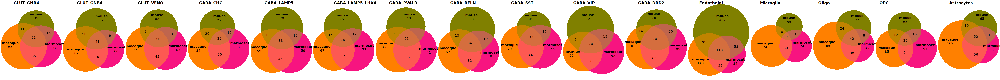

In [7]:
# colorLeg = c("human"="#E08B00", "macaque"="#A10035", "mouse"="#3FA796")
colorLeg = c("marmonset"="#FF8000", "macaque"="#F71480", "mouse"="#808000")
p1 = plot(elr1, quantities=T, fill=colorLeg, edges=F, labels=list(size=15))
p2 = plot(elr2, quantities=T, fill=colorLeg, edges=F, labels=list(size=15))
p3 = plot(elr3, quantities=T, fill=colorLeg, edges=F, labels=list(size=15))
p4 = plot(elr4, quantities=T, fill=colorLeg, edges=F, labels=list(size=15))
p5 = plot(elr5, quantities=T, fill=colorLeg, edges=F, labels=list(size=15))
p6 = plot(elr6, quantities=T, fill=colorLeg, edges=F, labels=list(size=15))
p7 = plot(elr7, quantities=T, fill=colorLeg, edges=F, labels=list(size=15))
p8 = plot(elr8, quantities=T, fill=colorLeg, edges=F, labels=list(size=15))
p9 = plot(elr9, quantities=T, fill=colorLeg, edges=F, labels=list(size=15))
p10 = plot(elr10, quantities=T, fill=colorLeg, edges=F, labels=list(size=15))
p11 = plot(elr11, quantities=T, fill=colorLeg, edges=F, labels=list(size=15))
p12 = plot(elr12, quantities=T, fill=colorLeg, edges=F, labels=list(size=15))
p13 = plot(elr13, quantities=T, fill=colorLeg, edges=F, labels=list(size=15))
p14 = plot(elr14, quantities=T, fill=colorLeg, edges=F, labels=list(size=15))
p15 = plot(elr15, quantities=T, fill=colorLeg, edges=F, labels=list(size=15))
p16 = plot(elr16, quantities=T, fill=colorLeg, edges=F, labels=list(size=15))


options(repr.plot.width=50, repr.plot.height=4)
pg = plot_grid(p1,p2,p3,p4,p5,p6,p7,p8,p9,p10,p11,p12,p13,p14,p15,p16, nrow=1, labels=c("GLUT_GNB4-","GLUT_GNB4+","GLUT_VENO","GABA_CHC",
 "GABA_LAMP5","GABA_LAMP5_LHX6","GABA_PVALB",'GABA_RELN','GABA_SST','GABA_VIP','GABA_DRD2',
"Endotheial",'Microglia','Oligo','OPC','Astrocytes'))
pg


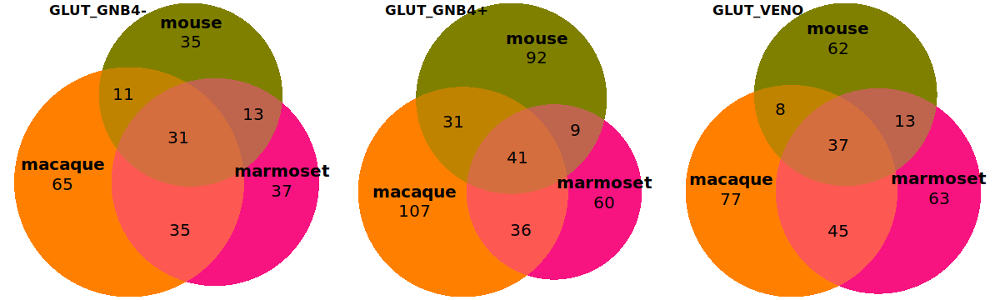

In [8]:

options(repr.plot.width=10, repr.plot.height=3)
pg = plot_grid(p1,p2,p3, nrow=1, label_size = 10,labels=c("GLUT_GNB4-","GLUT_GNB4+","GLUT_VENO"))
pg

In [80]:
pdf("/home/liuyx/liuyuxuan/spa_seurat/cla/fig_1206/fig6_renew_240118/venn_plot.pdf", width=50, height=4)
pg
dev.off()



png 
  2

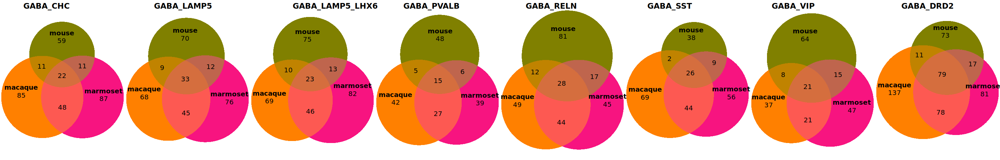

In [73]:
options(repr.plot.width=25, repr.plot.height=4)
pg = plot_grid(p4,p5,p6,p7,p8,p9,p10,p11, nrow=1, labels=c("GABA_CHC",
 "GABA_LAMP5","GABA_LAMP5_LHX6","GABA_PVALB",'GABA_RELN','GABA_SST','GABA_VIP','GABA_DRD2'))
pg


In [74]:
pdf("/home/liuyx/liuyuxuan/spa_seurat/cla/fig_1206/fig6_renew_240118/venn_plot2.pdf", width=25, height=4)
pg
dev.off()


png 
  2

In [11]:


Idents(sub_marmoset_marker) = "SuperCluster"
sub_marmoset_down100 = subset(sub_marmoset_marker, downsample=100)
Idents(sub_macaque_marker) = "SuperCluster"
sub_macaque_down100 = subset(sub_macaque_marker, downsample=100)
Idents(sub_mouse_marker) = "SuperCluster"
sub_mouse_down100 = subset(sub_mouse_marker, downsample=100)


In [12]:
in1=intersect(rownames(sub_marmoset_down100),rownames(sub_macaque_marker))
in2=rownames(sub_mouse_marker)
inter=intersect(in1,in2)
subclassFiltMarkerTb=subclassFiltMarkerTb[subclassFiltMarkerTb$gene %in% inter,]

# sortLevel = c("L2/3 IT", "L6 CT", "L4 IT", "L6 IT", "L5 IT", "L6b", "L5 PT", "L5/6 NP", "Car3")
sortLevel = unique(subclassFiltMarkerTb$cluster)


In [13]:
new_order=unique(sub_macaque_down100@meta.data[order(sub_macaque_down100$SuperCluster),]$SuperCluster)
new_order=as.character(new_order)
new_order=c(new_order[grep('GLUT',new_order)],new_order[grep('GABA',new_order)])
new_order1=setdiff(unique(sub_mouse_down100$SuperCluster),new_order)
new_order=c(new_order,new_order1)
new_order


[1] "GLUT_GNB4-"      "GLUT_GNB4+"      "GLUT_VENO"       "GABA_CHC"       
 [5] "GABA_DRD2"       "GABA_LAMP5"      "GABA_LAMP5_LHX6" "GABA_PVALB"     
 [9] "GABA_RELN"       "GABA_SST"        "GABA_VIP"        "Oligo"          
[13] "OPC"             "Endotheial"      "Microglia"       "Astrocytes"

In [14]:
unique(sub_macaque_down100$SuperCluster)

[1] "GLUT_VENO"       "GLUT_GNB4-"      "GLUT_GNB4+"      "GABA_VIP"       
 [5] "GABA_RELN"       "GABA_CHC"        "GABA_SST"        "GABA_PVALB"     
 [9] "GABA_LAMP5"      "GABA_LAMP5_LHX6" "Oligo"           "Astrocytes"     
[13] "Microglia"       "OPC"             "Endotheial"      "GABA_DRD2"

In [15]:
unique(subclassFiltMarkerTb$cluster)

[1] Astrocytes      Endotheial      GABA_CHC        GABA_DRD2      
 [5] GABA_LAMP5      GABA_LAMP5_LHX6 GABA_PVALB      GABA_RELN      
 [9] GABA_SST        GABA_VIP        GLUT_GNB4-      GLUT_GNB4+     
[13] GLUT_VENO       Microglia       Oligo           OPC            
16 Levels: Astrocytes Endotheial GABA_CHC GABA_DRD2 ... OPC

[1] 518

Scale for 'fill' is already present. Adding another scale for 'fill', which
will replace the existing scale.

Scale for 'fill' is already present. Adding another scale for 'fill', which
will replace the existing scale.

Scale for 'fill' is already present. Adding another scale for 'fill', which
will replace the existing scale.



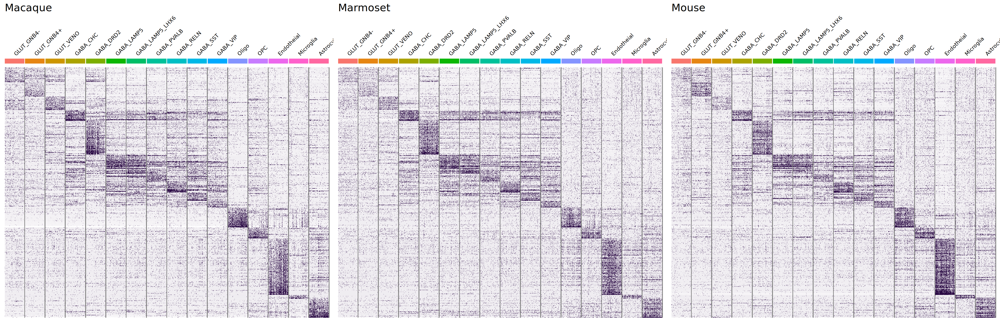

In [16]:

Idents(sub_macaque_down100)='SuperCluster'
Idents(sub_marmoset_down100)='SuperCluster'
Idents(sub_mouse_down100)='SuperCluster'
sub_macaque_down100$SuperCluster=factor(sub_macaque_down100$SuperCluster, levels=new_order)
sub_marmoset_down100$SuperCluster=factor(sub_marmoset_down100$SuperCluster, levels=new_order)
sub_mouse_down100$SuperCluster=factor(sub_mouse_down100$SuperCluster, levels=new_order)

subclassFiltMarkerTb$cluster=factor(subclassFiltMarkerTb$cluster,levels = new_order)
subclassFiltMarkerTb=subclassFiltMarkerTb[order(subclassFiltMarkerTb$cluster),]
selectGene = unique(subset(subclassFiltMarkerTb, conservedSpeciesPair=="macaque&marmoset&mouse")$gene)
conGeneLen = length(selectGene)
conGeneLen
heat.colors = colorRampPalette(c("white", "#F4F2F5", "#E9E6EC", "#2A0944"))(100)
Idents(sub_macaque_down100)='SuperCluster'
Idents(sub_marmoset_down100)='SuperCluster'
Idents(sub_mouse_down100)='SuperCluster'
options(repr.plot.width=40, repr.plot.height=length(selectGene)/40)
pg1 = plot_grid(
    DoHeatmap(sub_macaque_down100, features=selectGene) +
        ggtitle("Macaque") + 
        scale_fill_gradientn(colours=heat.colors) +
        theme(plot.title=element_text(size=30), axis.text.y=element_blank(), legend.position="none"),
    DoHeatmap(sub_marmoset_down100, features=selectGene) + 
        ggtitle("Marmoset") + 
        scale_fill_gradientn(colours=heat.colors) +
        theme(plot.title=element_text(size=30), axis.text.y=element_blank(), legend.position="none"),
    DoHeatmap(sub_mouse_down100, features=selectGene) + 
        ggtitle("Mouse") + 
        scale_fill_gradientn(colours=heat.colors) +
        theme(plot.title=element_text(size=30), axis.text.y=element_blank(), legend.position="none"),
    nrow=1, align="hv", axis="tblr"
)
pg1



[1] 1023

Scale for 'fill' is already present. Adding another scale for 'fill', which
will replace the existing scale.

Scale for 'fill' is already present. Adding another scale for 'fill', which
will replace the existing scale.

Scale for 'fill' is already present. Adding another scale for 'fill', which
will replace the existing scale.



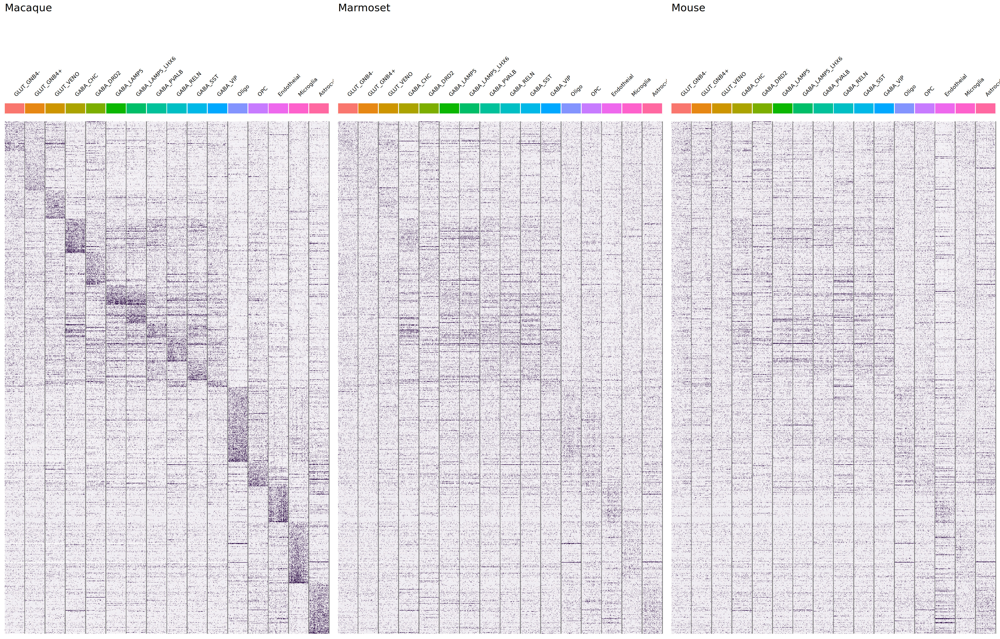

In [17]:
selectGene = unique(subset(subclassFiltMarkerTb, conservedSpeciesPair=="macaque")$gene)
conGeneLen = length(selectGene)
conGeneLen
heat.colors = colorRampPalette(c("white", "#F4F2F5", "#E9E6EC", "#2A0944"))(100)
options(repr.plot.width=40, repr.plot.height=length(selectGene)/40)
pg2 = plot_grid(
    DoHeatmap(sub_macaque_down100, features=selectGene) +
        ggtitle("Macaque") + 
        scale_fill_gradientn(colours=heat.colors) +
        theme(plot.title=element_text(size=30), axis.text.y=element_blank(), legend.position="none"),
    DoHeatmap(sub_marmoset_down100, features=selectGene) + 
        ggtitle("Marmoset") + 
        scale_fill_gradientn(colours=heat.colors) +
        theme(plot.title=element_text(size=30), axis.text.y=element_blank(), legend.position="none"),
    DoHeatmap(sub_mouse_down100, features=selectGene) + 
        ggtitle("Mouse") + 
        scale_fill_gradientn(colours=heat.colors) +
        theme(plot.title=element_text(size=30), axis.text.y=element_blank(), legend.position="none"),
    nrow=1, align="hv", axis="tblr"
)
pg2



[1] 636

Scale for 'fill' is already present. Adding another scale for 'fill', which
will replace the existing scale.

Scale for 'fill' is already present. Adding another scale for 'fill', which
will replace the existing scale.

Scale for 'fill' is already present. Adding another scale for 'fill', which
will replace the existing scale.



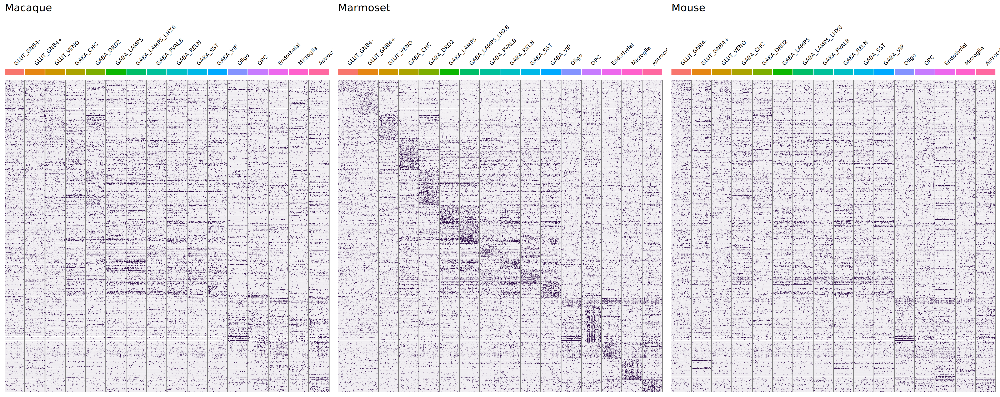

In [18]:

Idents(sub_macaque_down100)='SuperCluster'
Idents(sub_marmoset_down100)='SuperCluster'
Idents(sub_mouse_down100)='SuperCluster'
sub_macaque_down100$SuperCluster=factor(sub_macaque_down100$SuperCluster, levels=new_order)
sub_marmoset_down100$SuperCluster=factor(sub_marmoset_down100$SuperCluster, levels=new_order)
sub_mouse_down100$SuperCluster=factor(sub_mouse_down100$SuperCluster, levels=new_order)

subclassFiltMarkerTb$cluster=factor(subclassFiltMarkerTb$cluster,levels = new_order)
subclassFiltMarkerTb=subclassFiltMarkerTb[order(subclassFiltMarkerTb$cluster),]
selectGene = unique(subset(subclassFiltMarkerTb, conservedSpeciesPair=="marmoset")$gene)
conGeneLen = length(selectGene)
conGeneLen
heat.colors = colorRampPalette(c("white", "#F4F2F5", "#E9E6EC", "#2A0944"))(100)
options(repr.plot.width=40, repr.plot.height=length(selectGene)/40)

Idents(sub_macaque_down100)='SuperCluster'
Idents(sub_marmoset_down100)='SuperCluster'
Idents(sub_mouse_down100)='SuperCluster'
pg3 = plot_grid(
    DoHeatmap(sub_macaque_down100, features=selectGene) +
        ggtitle("Macaque") + 
        scale_fill_gradientn(colours=heat.colors) +
        theme(plot.title=element_text(size=30), axis.text.y=element_blank(), legend.position="none"),
    DoHeatmap(sub_marmoset_down100, features=selectGene) + 
        ggtitle("Marmoset") + 
        scale_fill_gradientn(colours=heat.colors) +
        theme(plot.title=element_text(size=30), axis.text.y=element_blank(), legend.position="none"),
    DoHeatmap(sub_mouse_down100, features=selectGene) + 
        ggtitle("Mouse") + 
        scale_fill_gradientn(colours=heat.colors) +
        theme(plot.title=element_text(size=30), axis.text.y=element_blank(), legend.position="none"),
    nrow=1, align="hv", axis="tblr"
)
pg3

[1] 892

Scale for 'fill' is already present. Adding another scale for 'fill', which
will replace the existing scale.

Scale for 'fill' is already present. Adding another scale for 'fill', which
will replace the existing scale.

Scale for 'fill' is already present. Adding another scale for 'fill', which
will replace the existing scale.



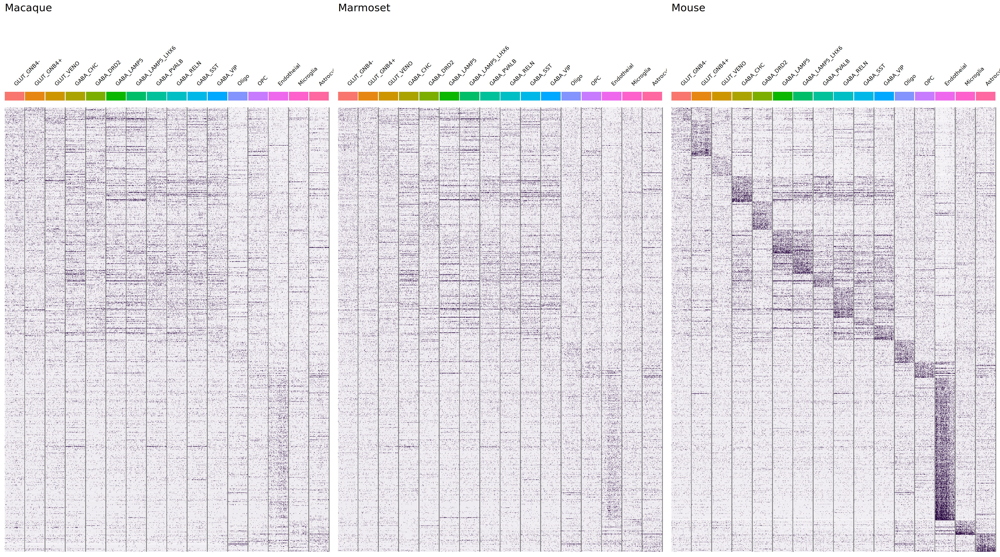

In [19]:

Idents(sub_macaque_down100)='SuperCluster'
Idents(sub_marmoset_down100)='SuperCluster'
Idents(sub_mouse_down100)='SuperCluster'
sub_macaque_down100$SuperCluster=factor(sub_macaque_down100$SuperCluster, levels=new_order)
sub_marmoset_down100$SuperCluster=factor(sub_marmoset_down100$SuperCluster, levels=new_order)
sub_mouse_down100$SuperCluster=factor(sub_mouse_down100$SuperCluster, levels=new_order)

subclassFiltMarkerTb$cluster=factor(subclassFiltMarkerTb$cluster,levels = new_order)
subclassFiltMarkerTb=subclassFiltMarkerTb[order(subclassFiltMarkerTb$cluster),]
selectGene = unique(subset(subclassFiltMarkerTb, conservedSpeciesPair=="mouse")$gene)
conGeneLen = length(selectGene)
conGeneLen
heat.colors = colorRampPalette(c("white", "#F4F2F5", "#E9E6EC", "#2A0944"))(100)
options(repr.plot.width=40, repr.plot.height=length(selectGene)/40)
pg7 = plot_grid(
    DoHeatmap(sub_macaque_down100, features=selectGene) +
        ggtitle("Macaque") + 
        scale_fill_gradientn(colours=heat.colors) +
        theme(plot.title=element_text(size=30), axis.text.y=element_blank(), legend.position="none"),
    DoHeatmap(sub_marmoset_down100, features=selectGene) + 
        ggtitle("Marmoset") + 
        scale_fill_gradientn(colours=heat.colors) +
        theme(plot.title=element_text(size=30), axis.text.y=element_blank(), legend.position="none"),
    DoHeatmap(sub_mouse_down100, features=selectGene) + 
        ggtitle("Mouse") + 
        scale_fill_gradientn(colours=heat.colors) +
        theme(plot.title=element_text(size=30), axis.text.y=element_blank(), legend.position="none"),
    nrow=1, align="hv", axis="tblr"
)
pg7

[1] 483

Scale for 'fill' is already present. Adding another scale for 'fill', which
will replace the existing scale.

Scale for 'fill' is already present. Adding another scale for 'fill', which
will replace the existing scale.

Scale for 'fill' is already present. Adding another scale for 'fill', which
will replace the existing scale.



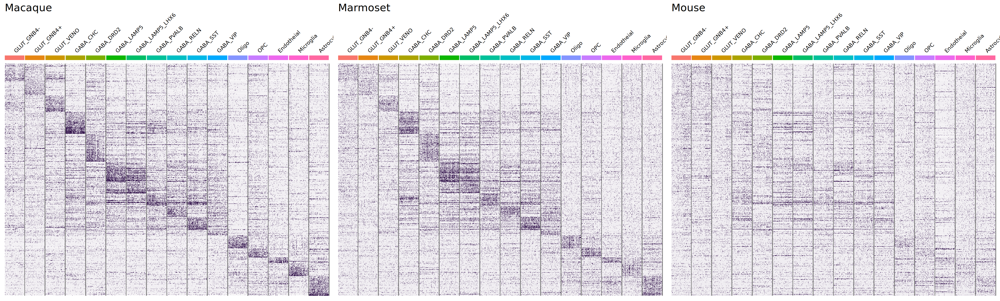

In [20]:

Idents(sub_macaque_down100)='SuperCluster'
Idents(sub_marmoset_down100)='SuperCluster'
Idents(sub_mouse_down100)='SuperCluster'
sub_macaque_down100$SuperCluster=factor(sub_macaque_down100$SuperCluster, levels=new_order)
sub_marmoset_down100$SuperCluster=factor(sub_marmoset_down100$SuperCluster, levels=new_order)
sub_mouse_down100$SuperCluster=factor(sub_mouse_down100$SuperCluster, levels=new_order)

subclassFiltMarkerTb$cluster=factor(subclassFiltMarkerTb$cluster,levels = new_order)
subclassFiltMarkerTb=subclassFiltMarkerTb[order(subclassFiltMarkerTb$cluster),]
selectGene = unique(subset(subclassFiltMarkerTb, conservedSpeciesPair=="macaque&marmoset")$gene)
conGeneLen = length(selectGene)
conGeneLen
heat.colors = colorRampPalette(c("white", "#F4F2F5", "#E9E6EC", "#2A0944"))(100)
options(repr.plot.width=40, repr.plot.height=length(selectGene)/40)
pg4 = plot_grid(
    DoHeatmap(sub_macaque_down100, features=selectGene) +
        ggtitle("Macaque") + 
        scale_fill_gradientn(colours=heat.colors) +
        theme(plot.title=element_text(size=30), axis.text.y=element_blank(), legend.position="none"),
    DoHeatmap(sub_marmoset_down100, features=selectGene) + 
        ggtitle("Marmoset") + 
        scale_fill_gradientn(colours=heat.colors) +
        theme(plot.title=element_text(size=30), axis.text.y=element_blank(), legend.position="none"),
    DoHeatmap(sub_mouse_down100, features=selectGene) + 
        ggtitle("Mouse") + 
        scale_fill_gradientn(colours=heat.colors) +
        theme(plot.title=element_text(size=30), axis.text.y=element_blank(), legend.position="none"),
    nrow=1, align="hv", axis="tblr"
)
pg4

[1] 243

Scale for 'fill' is already present. Adding another scale for 'fill', which
will replace the existing scale.

Scale for 'fill' is already present. Adding another scale for 'fill', which
will replace the existing scale.

Scale for 'fill' is already present. Adding another scale for 'fill', which
will replace the existing scale.



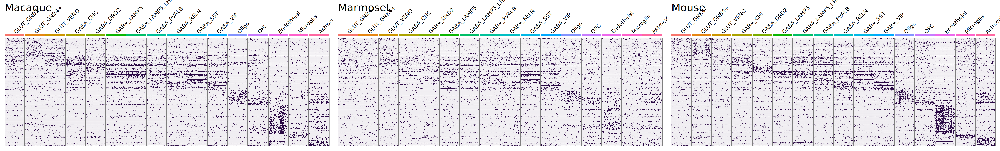

In [21]:

Idents(sub_macaque_down100)='SuperCluster'
Idents(sub_marmoset_down100)='SuperCluster'
Idents(sub_mouse_down100)='SuperCluster'
sub_macaque_down100$SuperCluster=factor(sub_macaque_down100$SuperCluster, levels=new_order)
sub_marmoset_down100$SuperCluster=factor(sub_marmoset_down100$SuperCluster, levels=new_order)
sub_mouse_down100$SuperCluster=factor(sub_mouse_down100$SuperCluster, levels=new_order)

subclassFiltMarkerTb$cluster=factor(subclassFiltMarkerTb$cluster,levels = new_order)
subclassFiltMarkerTb=subclassFiltMarkerTb[order(subclassFiltMarkerTb$cluster),]
selectGene = unique(subset(subclassFiltMarkerTb, conservedSpeciesPair=="macaque&mouse")$gene)
conGeneLen = length(selectGene)
conGeneLen
heat.colors = colorRampPalette(c("white", "#F4F2F5", "#E9E6EC", "#2A0944"))(100)
options(repr.plot.width=40, repr.plot.height=length(selectGene)/40)
pg5 = plot_grid(
    DoHeatmap(sub_macaque_down100, features=selectGene) +
        ggtitle("Macaque") + 
        scale_fill_gradientn(colours=heat.colors) +
        theme(plot.title=element_text(size=30), axis.text.y=element_blank(), legend.position="none"),
    DoHeatmap(sub_marmoset_down100, features=selectGene) + 
        ggtitle("Marmoset") + 
        scale_fill_gradientn(colours=heat.colors) +
        theme(plot.title=element_text(size=30), axis.text.y=element_blank(), legend.position="none"),
    DoHeatmap(sub_mouse_down100, features=selectGene) + 
        ggtitle("Mouse") + 
        scale_fill_gradientn(colours=heat.colors) +
        theme(plot.title=element_text(size=30), axis.text.y=element_blank(), legend.position="none"),
    nrow=1, align="hv", axis="tblr"
)
pg5

[1] 186

Scale for 'fill' is already present. Adding another scale for 'fill', which
will replace the existing scale.

Scale for 'fill' is already present. Adding another scale for 'fill', which
will replace the existing scale.

Scale for 'fill' is already present. Adding another scale for 'fill', which
will replace the existing scale.



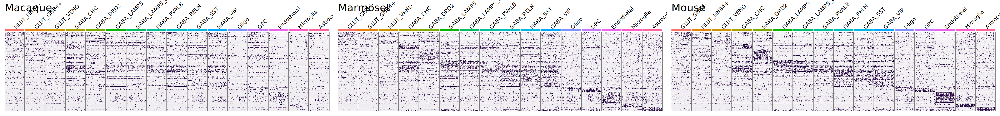

In [22]:

Idents(sub_macaque_down100)='SuperCluster'
Idents(sub_marmoset_down100)='SuperCluster'
Idents(sub_mouse_down100)='SuperCluster'
sub_macaque_down100$SuperCluster=factor(sub_macaque_down100$SuperCluster, levels=new_order)
sub_marmoset_down100$SuperCluster=factor(sub_marmoset_down100$SuperCluster, levels=new_order)
sub_mouse_down100$SuperCluster=factor(sub_mouse_down100$SuperCluster, levels=new_order)

subclassFiltMarkerTb$cluster=factor(subclassFiltMarkerTb$cluster,levels = new_order)
subclassFiltMarkerTb=subclassFiltMarkerTb[order(subclassFiltMarkerTb$cluster),]
selectGene = unique(subset(subclassFiltMarkerTb, conservedSpeciesPair=="marmoset&mouse")$gene)
conGeneLen = length(selectGene)
conGeneLen
heat.colors = colorRampPalette(c("white", "#F4F2F5", "#E9E6EC", "#2A0944"))(100)
options(repr.plot.width=40, repr.plot.height=length(selectGene)/40)
pg6 = plot_grid(
    DoHeatmap(sub_macaque_down100, features=selectGene) +
        ggtitle("Macaque") + 
        scale_fill_gradientn(colours=heat.colors) +
        theme(plot.title=element_text(size=30), axis.text.y=element_blank(), legend.position="none"),
    DoHeatmap(sub_marmoset_down100, features=selectGene) + 
        ggtitle("Marmoset") + 
        scale_fill_gradientn(colours=heat.colors) +
        theme(plot.title=element_text(size=30), axis.text.y=element_blank(), legend.position="none"),
    DoHeatmap(sub_mouse_down100, features=selectGene) + 
        ggtitle("Mouse") + 
        scale_fill_gradientn(colours=heat.colors) +
        theme(plot.title=element_text(size=30), axis.text.y=element_blank(), legend.position="none"),
    nrow=1, align="hv", axis="tblr"
)
pg6

In [23]:
pdf("/home/liuyx/liuyuxuan/spa_seurat/cla/fig_1206/fig6_renew_240118/heat11.pdf", width=40, height=518/40)
pg1
dev.off()

pdf("/home/liuyx/liuyuxuan/spa_seurat/cla/fig_1206/fig6_renew_240118/heat12.pdf", width=40, height=1023/40)
pg2
dev.off()

pdf("/home/liuyx/liuyuxuan/spa_seurat/cla/fig_1206/fig6_renew_240118/heat13.pdf", width=40, height=636/40)
pg3
dev.off()

pdf("/home/liuyx/liuyuxuan/spa_seurat/cla/fig_1206/fig6_renew_240118/heat14.pdf", width=40, height=483/40)
pg4
dev.off()

pdf("/home/liuyx/liuyuxuan/spa_seurat/cla/fig_1206/fig6_renew_240118/heat15.pdf", width=40, height=243/40)
pg5
dev.off()

pdf("/home/liuyx/liuyuxuan/spa_seurat/cla/fig_1206/fig6_renew_240118/heat16.pdf", width=40, height=186/40)
pg6
dev.off()

pdf("/home/liuyx/liuyuxuan/spa_seurat/cla/fig_1206/fig6_renew_240118/heat17.pdf", width=40, height=892/40)
pg7
dev.off()



png 
  2

png 
  2

png 
  2

png 
  2

png 
  2

png 
  2

png 
  2

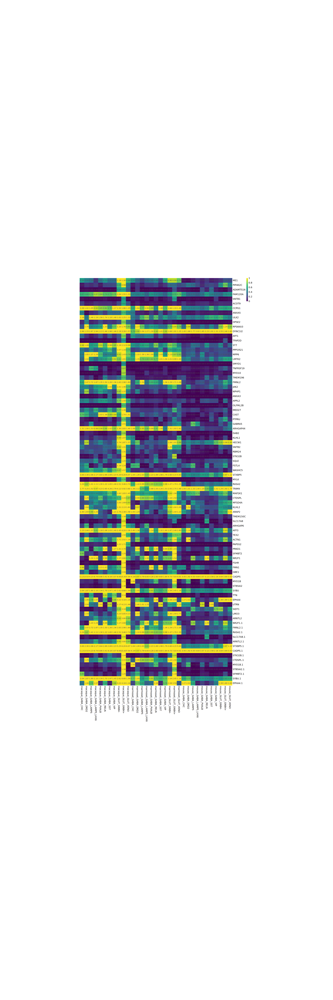

In [39]:
sub_marmoset_down100$species='marmoset'
sub_macaque_down100$species='macaque'
sub_mouse_down100$species='mouse'


df=sub_mouse_down100@assays$SCT@counts
rownames(df)=toupper(rownames(df))
renew_mouse=CreateSeuratObject(df)
renew_mouse=AddMetaData(renew_mouse,sub_mouse_down100@meta.data)
renew_mouse@assays$SCT=renew_mouse@assays$RNA

mer1=merge(sub_marmoset_down100,sub_macaque_down100)
mer2=merge(renew_mouse,mer1)
mer2$re=paste0(mer2$species,'_',mer2$SuperCluster)

sel_gene=subclassFiltMarkerTb[subclassFiltMarkerTb$cluster=='GLUT_GNB4+'
                     & subclassFiltMarkerTb$conservedSpeciesPair %in% c('macaque&marmoset','macaque','marmoset'),]$gene

df=as.data.frame(mer2@assays$SCT@counts[sel_gene,])
df=as.data.frame(t(df))
df$re=mer2@meta.data$re

df_re=split(df,df$re)

i=1
df_re[[i]]$re=NULL
df_sub=as.data.frame(apply(df_re[[i]],2,mean))
colnames(df_sub)=names(df_re)[i]
df_sum=df_sub
for(i in c(2:length(names(df_re)))){df_re[[i]]$re=NULL
df_sub=as.data.frame(apply(df_re[[i]],2,mean))
colnames(df_sub)=names(df_re)[i]
df_sum=cbind(df_sum,df_sub)}

df_sum$max=apply(df_sum,1,max)
df_sum=df_sum[df_sum$`macaque_GLUT_GNB4+`==df_sum$max,]
#df_sum=df_sum[df_sum$macaque_EXVENO_L6CT_like>2*(df_sum$mouse_EXVENO_L6b_like),]
#df_sum=df_sum[df_sum$macaque_EXVENO_L6CT_like>2*(df_sum$mouse_EXVENO_L6CT_like),]

df_sum$max=NULL
options(repr.plot.width=30, repr.plot.height=90)
pheatmap(df_sum
, breaks=seq(0,1,0.01), cluster_rows=F, cluster_cols=F, border_color=NA, cellwidth=30, cellheight=30, fontsize=15,
        color = viridis(100),display_numbers = T )



[1] "ULK2"   "LMTK2"  "JAK2"   "FSTL4"  "MAP2K1" "EPHA4"

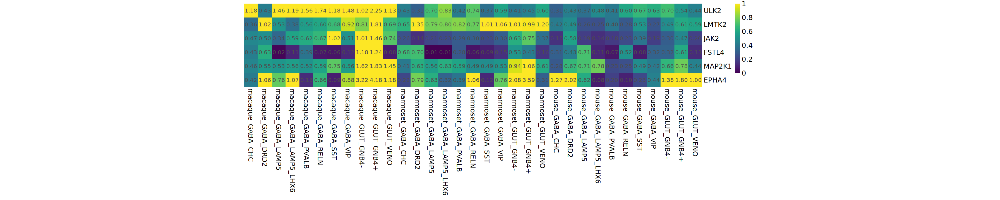

In [63]:
aba=getGO("GO:0061564")
intersect(rownames(df_sum),aba$`axon development`)
re_df=df_sum[intersect(rownames(df_sum),aba$`axon development`),]
options(repr.plot.width=30, repr.plot.height=nrow(re_df))
pheatmap(re_df
, breaks=seq(0,1,0.01), cluster_rows=F, cluster_cols=F, border_color=NA, cellwidth=30, cellheight=30, fontsize=15,
        color = viridis(100),display_numbers = T )



[1] "ULK2"   "LMTK2"  "FSTL4"  "MAP2K1" "EPHA4"

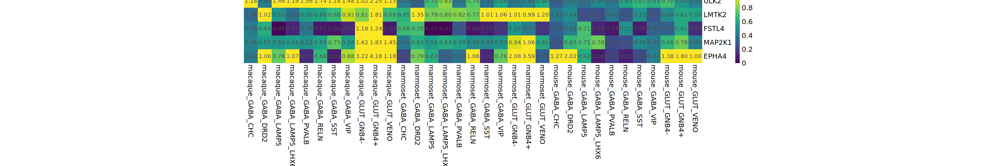

In [66]:
aba=getGO("GO:0007409")
intersect(rownames(df_sum),aba$axonogenesis)
re_df=df_sum[intersect(rownames(df_sum),aba$axonogenesis),]
options(repr.plot.width=30, repr.plot.height=nrow(re_df))
pheatmap(re_df
, breaks=seq(0,1,0.01), cluster_rows=F, cluster_cols=F, border_color=NA, cellwidth=30, cellheight=30, fontsize=15,
        color = viridis(100),display_numbers = T )



[1] "ULK2"     "ARHGAP44" "HECW1"    "FSTL4"    "WASHC5"   "MAP2K1"   "PRKD1"   
[8] "NR2F1"    "EPHA4"

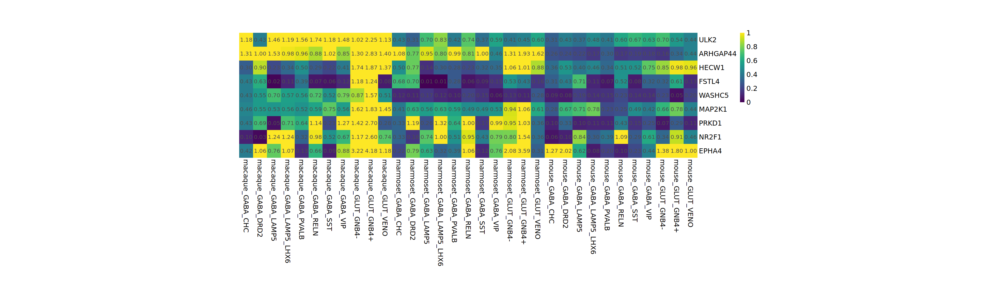

In [69]:
aba=getGO("GO:0010975")
intersect(rownames(df_sum),aba$`regulation of neuron projection development`)
re_df=df_sum[intersect(rownames(df_sum),aba$`regulation of neuron projection development`),]
options(repr.plot.width=30, repr.plot.height=nrow(re_df))
pheatmap(re_df
, breaks=seq(0,1,0.01), cluster_rows=F, cluster_cols=F, border_color=NA, cellwidth=30, cellheight=30, fontsize=15,
        color = viridis(100),display_numbers = T )



In [49]:
sub_maca_gnb=subset(sub_macaque_marker,SuperCluster=='GLUT_GNB4+')
sub_mouse_gnb=subset(sub_mouse_marker,SuperCluster=='GLUT_GNB4+')
sub_mouse_gnb$species='mouse'
sub_maca_gnb$species='macaque'
mer=merge(sub_mouse_gnb,sub_maca_gnb)

Idents(mer) = "species"
sub_mer=subset(mer,downsample=500)


DefaultAssay(sub_mer) = "RNA"
speciesMarker = FindAllMarkers(sub_mer)


Calculating cluster mouse

Calculating cluster macaque



In [52]:
speciesMarker=speciesMarker[speciesMarker$cluster=='macaque',]

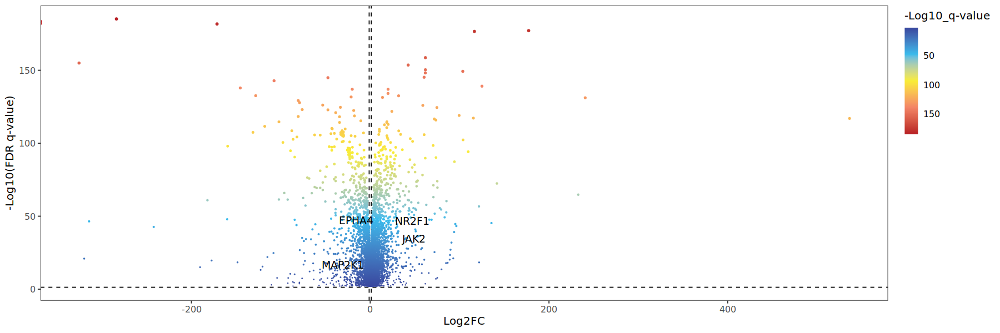

In [54]:
sub_data=speciesMarker
options(repr.plot.width=15, repr.plot.height=5)
core_gene=c('EPHA4','NR2F1','MAP2K1','JAK2')
ggplot(sub_data,aes(avg_log2FC, -log10(p_val)))+
  geom_hline(yintercept = -log10(0.05), linetype = "dashed", color = "black")+
  geom_vline(xintercept = c(-1.2,1.2), linetype = "dashed", color = "black")+
  geom_point(aes(size = -log10(p_val), 
                 color = -log10(p_val)))+
  scale_color_gradientn(values = seq(0,1,0.2),
                        colors = c("#39489f","#39bbec","#f9ed36","#f38466","#b81f25"))+
  scale_size_continuous(range = c(0,1))+
  theme_bw(base_size = 12)+
  theme(panel.grid = element_blank(),
        legend.position = 'right',
        legend.justification = c(0,1))+
  # 设置图例
  guides(col = 
           guide_colorbar(title = "-Log10_q-value",
                          ticks.colour = NA,
                          reverse = T,
                          title.vjust = 0.8,
                          barheight = 8,
                          barwidth = 1),
         size = "none") +
  # 添加标签：
  geom_text_repel(data = filter(sub_data, gene %in% core_gene),
                  max.overlaps = getOption("ggrepel.max.overlaps", default = 20),
                  # 这里的filter很关键，筛选你想要标记的基因
                  aes(label = gene),
                  size = 4, 
                  color = 'black') +
  xlab("Log2FC")+
  ylab("-Log10(FDR q-value)")


In [36]:
sub_data=macaqueSubclassMarker[macaqueSubclassMarker$cluster=='GLUT_GNB4+'
                    # & subclassFiltMarkerTb$conservedSpeciesPair %in% c('macaque&marmoset','macaque','marmoset')
                              ,]
sub_data[sub_data$gene=='JAK2',]


,X,p_val,avg_log2FC,pct.1,pct.2,p_val_adj,cluster,gene
,<chr>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<chr>,<chr>
1888,JAK2,4.41178e-92,0.6166275,0.654,0.343,8.164882e-88,GLUT_GNB4+,JAK2


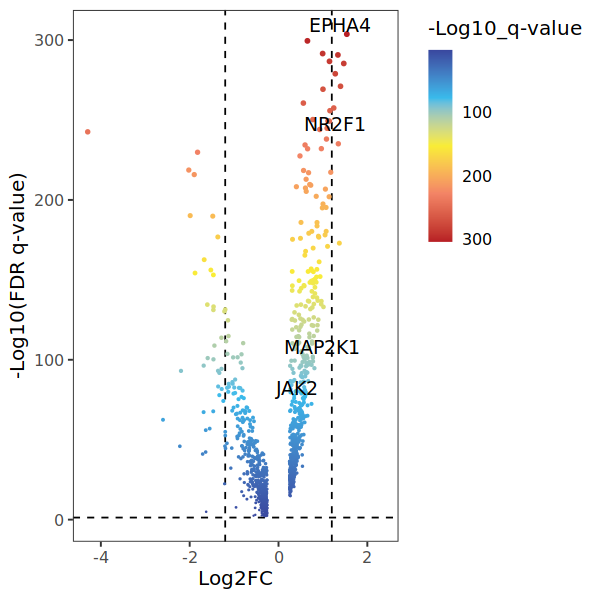

In [39]:
options(repr.plot.width=5, repr.plot.height=5)
core_gene=c('EPHA4','NR2F1','MAP2K1','JAK2')
ggplot(sub_data,aes(avg_log2FC, -log10(p_val)))+
  geom_hline(yintercept = -log10(0.05), linetype = "dashed", color = "black")+
  geom_vline(xintercept = c(-1.2,1.2), linetype = "dashed", color = "black")+
  geom_point(aes(size = -log10(p_val), 
                 color = -log10(p_val)))+
  scale_color_gradientn(values = seq(0,1,0.2),
                        colors = c("#39489f","#39bbec","#f9ed36","#f38466","#b81f25"))+
  scale_size_continuous(range = c(0,1))+
  theme_bw(base_size = 12)+
  theme(panel.grid = element_blank(),
        legend.position = 'right',
        legend.justification = c(0,1))+
  # 设置图例
  guides(col = 
           guide_colorbar(title = "-Log10_q-value",
                          ticks.colour = NA,
                          reverse = T,
                          title.vjust = 0.8,
                          barheight = 8,
                          barwidth = 1),
         size = "none") +
  # 添加标签：
  geom_text_repel(data = filter(sub_data, gene %in% core_gene),
                  max.overlaps = getOption("ggrepel.max.overlaps", default = 20),
                  # 这里的filter很关键，筛选你想要标记的基因
                  aes(label = gene),
                  size = 4, 
                  color = 'black') +
  xlab("Log2FC")+
  ylab("-Log10(FDR q-value)")


'select()' returned 1:many mapping between keys and columns

Warning message in bitr(marker_sel, fromType = "SYMBOL", toType = c("ENSEMBL", "ENTREZID"), :
“0.58% of input gene IDs are fail to map...”


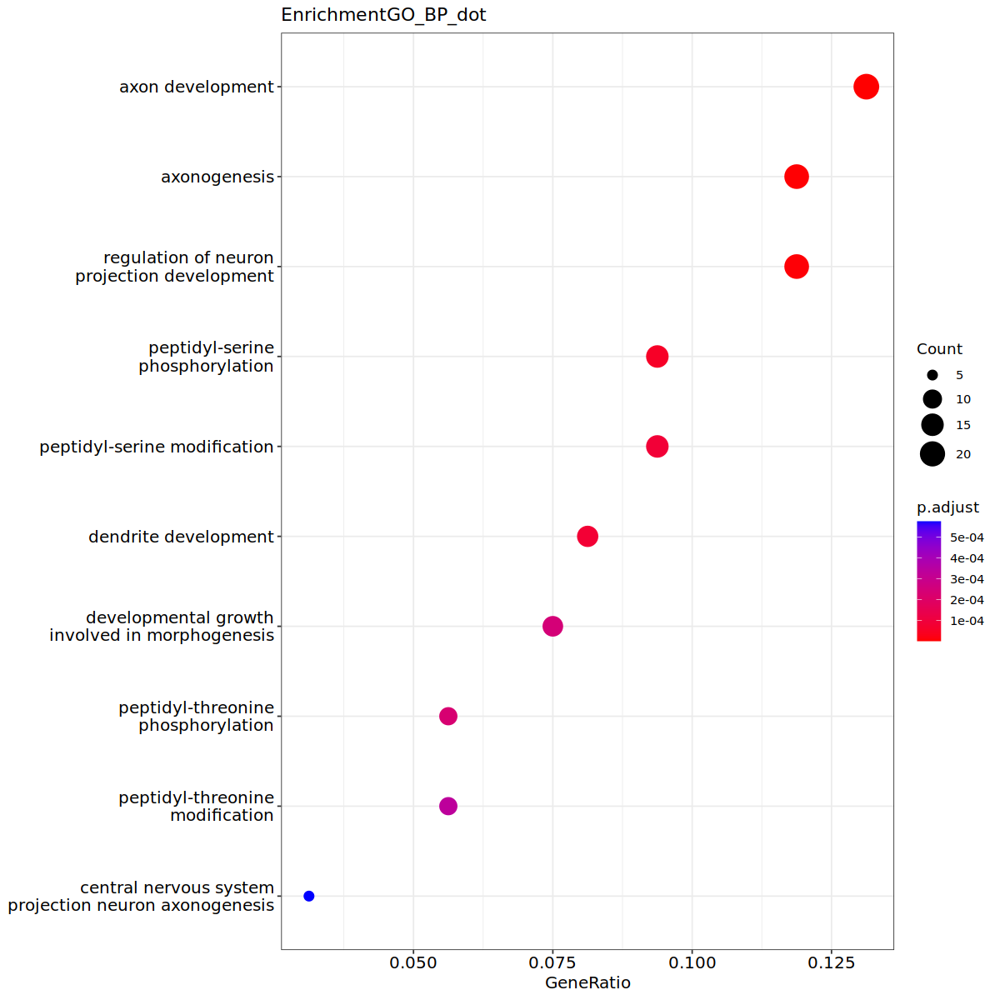

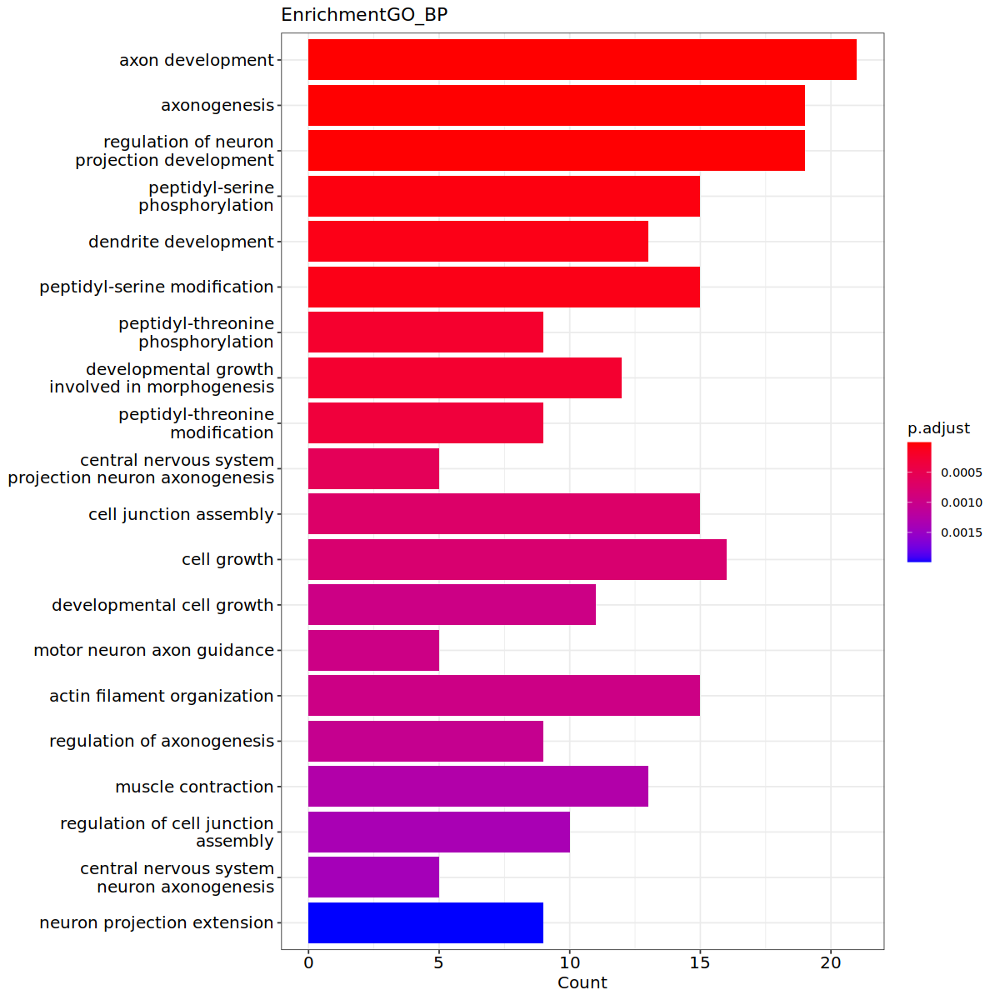

In [74]:
baoshou=subclassFiltMarkerTb[subclassFiltMarkerTb$cluster=='GLUT_GNB4+'
                     & subclassFiltMarkerTb$conservedSpeciesPair %in% c('macaque&marmoset','macaque','marmoset'),]$gene

marker_sel=baoshou
#test1 = bitr(sub_df$Var1, fromType="SYMBOL", toType=c("ENSEMBL", "ENTREZID"), OrgDb="org.Hs.eg.db")
test1 = bitr(marker_sel, fromType="SYMBOL", toType=c("ENSEMBL", "ENTREZID"), OrgDb="org.Hs.eg.db")

#ego_MF <- enrichGO(gene = test1$ENTREZID,
#                   OrgDb = org.Hs.eg.db,
#                   ont = "MF",
#                   pAdjustMethod = "BH",
#                   pvalueCutoff = 1,
#                   qvalueCutoff = 1,readable = FALSE)

ego_BP <- enrichGO(gene = test1$ENTREZID,
                   OrgDb = org.Hs.eg.db,
                   ont = "BP",
                   pAdjustMethod = "BH",
                   pvalueCutoff = 1,
                   qvalueCutoff = 1,readable = FALSE)

#ego_CC <- enrichGO(gene = test1$ENTREZID,
#                   OrgDb = org.Hs.eg.db,
#                   ont = "CC",
#                   pAdjustMethod = "BH",
#                   pvalueCutoff = 1,
#                   qvalueCutoff = 1,readable = FALSE)

options(repr.plot.width=10, repr.plot.height=10)
##可视化--点图
gp1=dotplot(ego_BP,title="EnrichmentGO_BP_dot")#点图，按富集的数从大到小的
##可视化--条形图
gp2=barplot(ego_BP, showCategory=20,title="EnrichmentGO_BP")#条状图，按p从小到大排，绘制前20个Term
gp1
gp2
##可视化--点图
#dotplot(ego_CC,title="EnrichmentGO_CC_dot")#点图，按富集的数从大到小的
##可视化--条形图
#barplot(ego_CC, showCategory=20,title="EnrichmentGO_CC")#条状图，按p从小到大排，绘制前20个Term

##可视化--点图
#dotplot(ego_MF,title="EnrichmentGO_MF_dot")#点图，按富集的数从大到小的
##可视化--条形图
#barplot(ego_MF, showCategory=20,title="EnrichmentGO_MF")#条状图，按p从小到大排，绘制前20个Term


In [75]:
pdf("/home/liuyx/liuyuxuan/spa_seurat/cla/fig_1206/fig6_renew_240118/EXGNB4_like_MF_GO1.pdf", width=10, height=10)
gp1
dev.off()



png 
  2

In [73]:
pdf("/home/liuyx/liuyuxuan/spa_seurat/cla/fig_1206/fig6_renew_240118/EXVENO_like_MF_GO1.pdf", width=10, height=10)
gp1
dev.off()




png 
  2

In [42]:
findGO <- function(pattern, method = "key"){

    if(!exists("GO_DATA"))
        load("GO_DATA.RData")
    if(method == "key"){
        pathways = cbind(GO_DATA$PATHID2NAME[grep(pattern, GO_DATA$PATHID2NAME)])
    } else if(method == "gene"){
        pathways = cbind(GO_DATA$PATHID2NAME[GO_DATA$EXTID2PATHID[[pattern]]])
    }

    colnames(pathways) = "pathway"

    if(length(pathways) == 0){
        cat("No results!\n")
    } else{
        return(pathways)
    }
}

getGO <- function(ID){

    if(!exists("GO_DATA"))
        load("GO_DATA.RData")
    allNAME = names(GO_DATA$PATHID2EXTID)
    if(ID %in% allNAME){
        geneSet = GO_DATA$PATHID2EXTID[ID]
        names(geneSet) = GO_DATA$PATHID2NAME[ID]
        return(geneSet)     
    } else{
        cat("No results!\n")
    }
}

In [49]:

GO_DATA <- get_GO_data("org.Hs.eg.db", "ALL", "SYMBOL")
save(GO_DATA, file = "GO_DATA.RData")
load("GO_DATA.RData") 



,pathway
GO:0048893,afferent axon development in lateral line nerve
GO:0048894,efferent axon development in a lateral line nerve
GO:0048910,afferent axon development in anterior lateral line nerve
GO:0048911,efferent axon development in anterior lateral line nerve
GO:0048929,efferent axon development in posterior lateral line nerve
GO:0048933,afferent axon development in posterior lateral line nerve
GO:0061564,axon development


In [67]:
findGO("regulation of neuron") 

,pathway
GO:0010975,regulation of neuron projection development
GO:0010976,positive regulation of neuron projection development
GO:0010977,negative regulation of neuron projection development
GO:0014041,regulation of neuron maturation
GO:0014042,positive regulation of neuron maturation
GO:0014043,negative regulation of neuron maturation
GO:0031637,regulation of neuronal synaptic plasticity in response to neurotrophin
GO:0043523,regulation of neuron apoptotic process
GO:0043524,negative regulation of neuron apoptotic process
GO:0043525,positive regulation of neuron apoptotic process


In [51]:
getGO("GO:0061564") 

$`axon development`
  [1] "ABL1"     "ACTB"     "ADARB1"   "ADCY1"    "ALCAM"    "ANK3"    
  [7] "APBB1"    "APOA1"    "APOD"     "APOE"     "APP"      "RHOG"    
 [13] "ARHGAP4"  "RHOH"     "ATOH1"    "ADGRB1"   "BCL2"     "BDNF"    
 [19] "BMP7"     "BMPR1B"   "BMPR2"    "BSG"      "TSPO"     "DDR1"    
 [25] "CASP3"    "CCK"      "CCKAR"    "CDH2"     "CDH4"     "CDH11"   
 [31] "CDK5"     "CHN1"     "CHRNB2"   "CNP"      "CNR1"     "CNTF"    
 [37] "CRABP2"   "CREB1"    "CRMP1"    "CTNNA1"   "CTNNA2"   "DAB1"    
 [43] "DAG1"     "DBN1"     "DCC"      "DHFR"     "DLX5"     "DNM2"    
 [49] "DPYSL2"   "DRD2"     "DSCAM"    "DVL1"     "EFNA1"    "EFNA2"   
 [55] "EFNA3"    "EFNA4"    "EFNA5"    "EFNB1"    "EFNB2"    "EFNB3"   
 [61] "MEGF8"    "EGR2"     "EPHA2"    "EIF4G2"   "MARK2"    "CTTN"    
 [67] "EPHA1"    "EPHA3"    "EPHA4"    "EPHA5"    "EPHA7"    "EPHA8"   
 [73] "EPHB1"    "EPHB2"    "EPHB3"    "EPHB4"    "EPHB6"    "ERBB2"   
 [79] "ETV1"     "EVX1"     "EXT1"     "FGF8"     "FGF13"    "FGFR2"   
 [85] "FKBP1B"   "FOXG1"    "FOXD1"    "FLNA"     "FN1"      "FOLR1"   
 [91] "FYN"      "GAP43"    "GATA3"    "GBX1"     "GBX2"     "GDI1"    
 [97] "GDNF"     "GFRA3"    "GLI2"     "GLI3"     "GOLGA4"   "GRN"     
[103] "ARHGAP35" "GRM7"     "GSK3B"    "HOXA2"    "HSP90AA1" "HSP90AB1"
[109] "TNC"      "ILK"      "ISL1"     "ITGA4"    "ITGB1"    "JAK2"    
[115] "ANOS1"    "KEL"      "KIF5A"    "KIF5B"    "KIF5C"    "L1CAM"   
[121] "LAMA2"    "LAMA3"    "LAMA5"    "LAMB2"    "LAMC2"    "STMN1"   
[127] "LHX1"     "LIMK1"    "LLGL1"    "LMX1A"    "LRP1"     "LRP4"    
[133] "SMAD4"    "MAG"      "MAP1A"    "MAP1B"    "MAP2"     "MAP6"    
[139] "MAPT"     "MCF2"     "RAB8A"    "MT3"      "MTR"      "NCAM1"   
[145] "NCAM2"    "NDN"      "NEFH"     "NEFL"     "NEO1"     "NFIB"    
[151] "NGF"      "NGFR"     "NKX6-1"   "NOTCH1"   "NOTCH2"   "NOTCH3"  
[157] "NOVA2"    "NPTX1"    "NRCAM"    "NTRK1"    "NTRK2"    "NTN3"    
[163] "NR4A2"    "OPHN1"    "OTX2"     "PAFAH1B1" "PAK1"     "PAK2"    
[169] "PAK3"     "PAX2"     "PAX6"     "PLP1"     "PLXNA1"   "PLXNA2"  
[175] "PLXNB1"   "PLXNB3"   "POU3F2"   "POU4F1"   "POU4F2"   "POU4F3"  
[181] "PPP3CB"   "PRKCQ"    "MAP2K1"   "RELN"     "PSEN1"    "PTCH1"   
[187] "PTEN"     "PTK2"     "PTN"      "PTPN11"   "PTPRF"    "PTPRM"   
[193] "PTPRO"    "PTPRS"    "PTPRZ1"   "NECTIN1"  "RAB3A"    "RAC1"    
[199] "RAC2"     "RET"      "RNF6"     "ROBO1"    "ROBO2"    "RPL24"   
[205] "RYK"      "S100A6"   "S100B"    "SCN1B"    "CXCL12"   "SEMA3F"  
[211] "SHH"      "SHOX2"    "SIAH1"    "SKIL"     "SLIT1"    "SLIT3"   
[217] "SMO"      "SOS1"     "SPAST"    "SPP1"     "SRF"      "CDKL5"   
[223] "STK11"    "STXBP1"   "CNTN2"    "DYNLT1"   "THY1"     "TIAM1"   
[229] "NKX2-1"   "NR2E1"    "TNR"      "TOP2B"    "TRIO"     "TRPC5"   
[235] "UCHL1"    "VASP"     "VCL"      "VEGFA"    "WNT3"     "WNT5A"   
[241] "WNT7A"    "SEMA3B"   "FZD3"     "LHX3"     "RND2"     "USP9X"   
[247] "PICALM"   "PLA2G10"  "ULK1"     "STK24"    "SEMA7A"   "TMEFF1"  
[253] "SCARF1"   "KLF7"     "UNC5C"    "NUMB"     "RAB11A"   "NRP2"    
[259] "NRP1"     "SYNGAP1"  "CDK5R1"   "ZPR1"     "PHOX2B"   "KALRN"   
[265] "BRSK2"    "SEMA5A"   "ARTN"     "MAP3K13"  "DCLK1"    "LGI1"    
[271] "NOG"      "RPS6KA5"  "NUMBL"    "KLF4"     "NREP"     "B4GALT6" 
[277] "B4GALT5"  "TAOK2"    "SLIT2"    "LHX2"     "NRXN3"    "NRXN1"   
[283] "NTN1"     "MYOT"     "FEZ2"     "FEZ1"     "ULK2"     "SEMA3E"  
[289] "IST1"     "KIAA0319" "LRIG2"    "PLPPR4"   "HDAC6"    "UST"     
[295] "TSPAN2"   "PLXNC1"   "FLOT1"    "SPRY3"    "SEMA3A"   "TUBB3"   
[301] "OLFM1"    "BAIAP2"   "SLC9A6"   "STK25"    "SEMA6C"   "SEMA6B"  
[307] "SEMA4F"   "SEMA4D"   "SEMA4B"   "SEMA3C"   "B3GNT2"   "TBR1"    
[313] "CHL1"     "RAB10"    "AFG3L2"   "VAX1"     "KLK8"     "LYPLA2"  
[319] "TWF2"     "LMTK2"    "NTNG1"    "SLITRK3"  "INPP5F"   "RUFY3"   
[325] "TRAK1"    "TRIM32"   "RAB21"    "PALLD"    "USP33"    "MYCBP2"  
[331] "FSTL4"    "SP

In [48]:
library(DOSE)
library(GOSemSim)
library(clusterProfiler)
library(org.Hs.eg.db)
# library(org.Mm.eg.db)
# library(org.Rn.eg.db)
library(dplyr)
library(GO.db)
#
get_GO_data <- function(OrgDb, ont, keytype) {
  GO_Env <- get_GO_Env()
  use_cached <- FALSE
  
  if (exists("organism", envir=GO_Env, inherits=FALSE) &&
      exists("keytype", envir=GO_Env, inherits=FALSE)) {
    
    org <- get("organism", envir=GO_Env)
    kt <- get("keytype", envir=GO_Env)
    
    if (org == DOSE:::get_organism(OrgDb) &&
        keytype == kt &&
        exists("goAnno", envir=GO_Env, inherits=FALSE)) {
      ## https://github.com/GuangchuangYu/clusterProfiler/issues/182
      ## && exists("GO2TERM", envir=GO_Env, inherits=FALSE)){
      
      use_cached <- TRUE
    }
  }
  
  if (use_cached) {
    goAnno <- get("goAnno", envir=GO_Env)
  } else {
    OrgDb <- GOSemSim:::load_OrgDb(OrgDb)
    kt <- keytypes(OrgDb)
    if (! keytype %in% kt) {
      stop("keytype is not supported...")
    }
    
    kk <- keys(OrgDb, keytype=keytype)
    goAnno <- suppressMessages(
      AnnotationDbi::select(OrgDb, keys=kk, keytype=keytype,
             columns=c("GOALL", "ONTOLOGYALL")))
    
    goAnno <- unique(goAnno[!is.na(goAnno$GOALL), ])
    
    assign("goAnno", goAnno, envir=GO_Env)
    assign("keytype", keytype, envir=GO_Env)
    assign("organism", DOSE:::get_organism(OrgDb), envir=GO_Env)
  }
  
  if (ont == "ALL") {
    GO2GENE <- unique(goAnno[, c(2,1)])
  } else {
    GO2GENE <- unique(goAnno[goAnno$ONTOLOGYALL == ont, c(2,1)])
  }
  
  GO_DATA <- DOSE:::build_Anno(GO2GENE, get_GO2TERM_table())
  
  goOnt.df <- goAnno[, c("GOALL", "ONTOLOGYALL")] %>% unique
  goOnt <- goOnt.df[,2]
  names(goOnt) <- goOnt.df[,1]
  assign("GO2ONT", goOnt, envir=GO_DATA)
  return(GO_DATA)
}

get_GO_Env <- function () {
  if (!exists(".GO_clusterProfiler_Env", envir = .GlobalEnv)) {
    pos <- 1
    envir <- as.environment(pos)
    assign(".GO_clusterProfiler_Env", new.env(), envir=envir)
  }
  get(".GO_clusterProfiler_Env", envir = .GlobalEnv)
}

get_GO2TERM_table <- function() {
  GOTERM.df <- get_GOTERM()
  GOTERM.df[, c("go_id", "Term")] %>% unique
}

get_GOTERM <- function() {
  pos <- 1
  envir <- as.environment(pos)
  if (!exists(".GOTERM_Env", envir=envir)) {
    assign(".GOTERM_Env", new.env(), envir)
  }
  GOTERM_Env <- get(".GOTERM_Env", envir = envir)
  if (exists("GOTERM.df", envir = GOTERM_Env)) {
    GOTERM.df <- get("GOTERM.df", envir=GOTERM_Env)
  } else {
    GOTERM.df <- toTable(GOTERM)
    assign("GOTERM.df", GOTERM.df, envir = GOTERM_Env)
  }
  return(GOTERM.df)
}

DOSE v3.20.1  For help: https://yulab-smu.top/biomedical-knowledge-mining-book/

If you use DOSE in published research, please cite:
Guangchuang Yu, Li-Gen Wang, Guang-Rong Yan, Qing-Yu He. DOSE: an R/Bioconductor package for Disease Ontology Semantic and Enrichment analysis. Bioinformatics 2015, 31(4):608-609


GOSemSim v2.20.0  For help: https://yulab-smu.top/biomedical-knowledge-mining-book/

If you use GOSemSim in published research, please cite:
- Guangchuang Yu. Gene Ontology Semantic Similarity Analysis Using GOSemSim. In: Kidder B. (eds) Stem Cell Transcriptional Networks. Methods in Molecular Biology, 2020, 2117:207-215. Humana, New York, NY. doi:10.1007/978-1-0716-0301-7_11
- Guangchuang Yu, Fei Li, Yide Qin, Xiaochen Bo, Yibo Wu, Shengqi Wang. GOSemSim: an R package for measuring semantic similarity among GO terms and gene products Bioinformatics 2010, 26(7):976-978. doi:10.1093/bioinformatics/btq064




Attaching package: ‘GOSemSim’


The following objects are masked from ‘

In [71]:
pdf("/home/liuyx/liuyuxuan/spa_seurat/cla/fig_1206/fig6_renew_240118/EXVENO_like_MF_GO1.pdf", width=10, height=10)
gp1
dev.off()

pdf("/home/liuyx/liuyuxuan/spa_seurat/cla/fig_1206/fig6_renew_240118/EXVENO_likeMF_GO2.pdf", width=10, height=10)
gp2
dev.off()

png 
  2

png 
  2

In [72]:
library(DOSE)

DOSE v3.20.1  For help: https://yulab-smu.top/biomedical-knowledge-mining-book/

If you use DOSE in published research, please cite:
Guangchuang Yu, Li-Gen Wang, Guang-Rong Yan, Qing-Yu He. DOSE: an R/Bioconductor package for Disease Ontology Semantic and Enrichment analysis. Bioinformatics 2015, 31(4):608-609




'select()' returned 1:many mapping between keys and columns

'select()' returned 1:many mapping between keys and columns

Warning message in bitr(macaqueSubclassMarker$gene, fromType = "SYMBOL", toType = c("ENSEMBL", :
“7.53% of input gene IDs are fail to map...”


,ID,Description,GeneRatio,BgRatio,pvalue,p.adjust,qvalue,geneID,Count
,<chr>,<chr>,<chr>,<chr>,<dbl>,<dbl>,<dbl>,<chr>,<int>
DOID:2621,DOID:2621,autonomic nervous system neoplasm,14/90,82/1440,0.0003330373,0.05424173,0.05096002,3791/481/11170/4842/4852/6857/238/3815/351/444/5629/7220/3479/9353,14
DOID:769,DOID:769,neuroblastoma,14/90,82/1440,0.0003330373,0.05424173,0.05096002,3791/481/11170/4842/4852/6857/238/3815/351/444/5629/7220/3479/9353,14
DOID:1192,DOID:1192,peripheral nervous system neoplasm,14/90,83/1440,0.0003801991,0.05424173,0.05096002,3791/481/11170/4842/4852/6857/238/3815/351/444/5629/7220/3479/9353,14


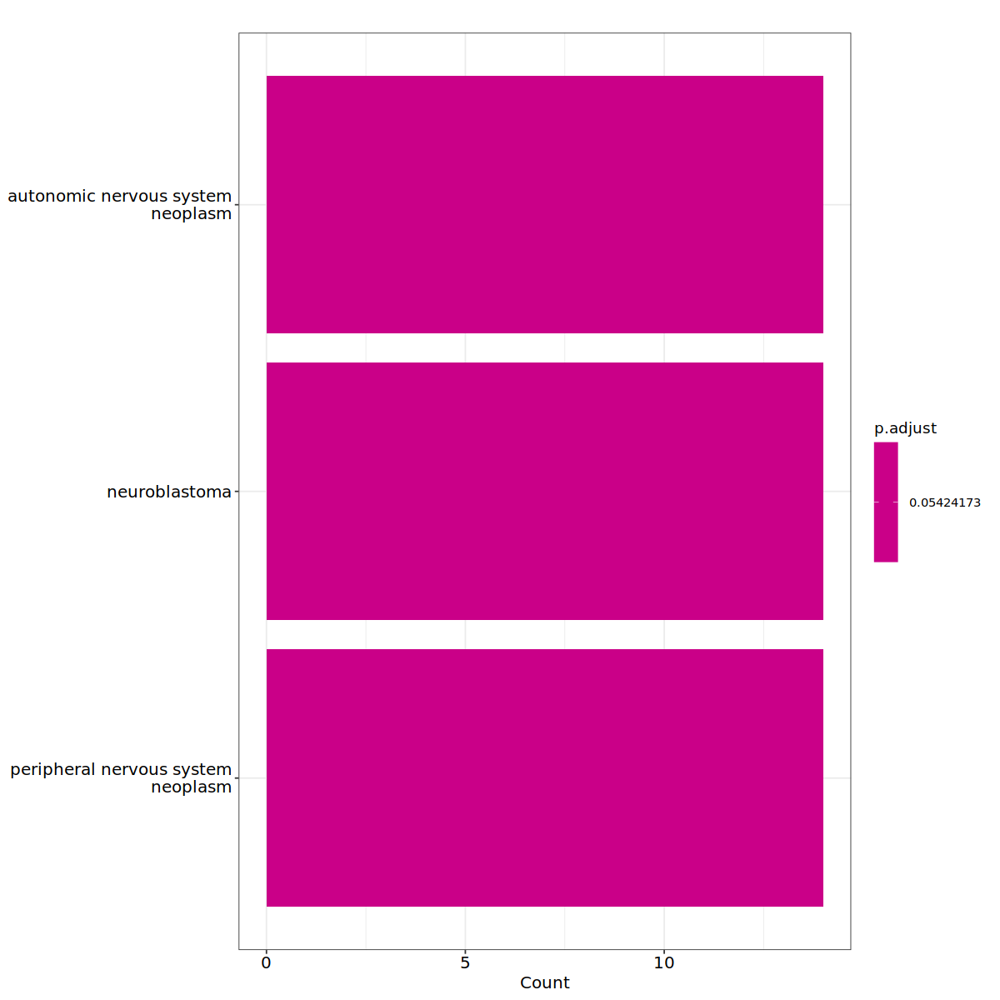

In [77]:
gnb4_gene=subclassFiltMarkerTb[subclassFiltMarkerTb$cluster=='GABA_LAMP5_LHX6'
                     & subclassFiltMarkerTb$conservedSpeciesPair %in% c('macaque&marmoset','macaque','marmoset'),]$gene

marker_sel=gnb4_gene
#test1 = bitr(sub_df$Var1, fromType="SYMBOL", toType=c("ENSEMBL", "ENTREZID"), OrgDb="org.Hs.eg.db")
test1 = bitr(marker_sel, fromType="SYMBOL", toType=c("ENSEMBL", "ENTREZID"), OrgDb="org.Hs.eg.db")
test2 = bitr(macaqueSubclassMarker$gene, fromType="SYMBOL", toType=c("ENSEMBL", "ENTREZID"), OrgDb="org.Hs.eg.db")

x <- enrichDO(gene          = test1$ENTREZID,
              ont           = "DO",
              pvalueCutoff  = 0.1,
              pAdjustMethod = "BH",
              universe      = test2$ENTREZID,
              minGSSize     = 5,
              maxGSSize     = 10000,
              qvalueCutoff  = 0.1,
              readable      = FALSE)
head(x)

barplot(x,showCategory = 10)